In [6]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [7]:
#jpg랑 xml 분리하기
data_jpg=[]
data_xml=[]

for filename in os.listdir('/kaggle/input/fruit-images-for-object-detection/train_zip/train'):
    if filename.split('.')[1] == 'jpg':
        data_jpg.append('/kaggle/input/fruit-images-for-object-detection/train_zip/train/'+filename)
    else :
        data_xml.append('/kaggle/input/fruit-images-for-object-detection/train_zip/train/'+filename)

data_jpg.sort()
data_xml.sort()

# 정렬잘됐나 확인
print(data_jpg[0],data_xml[0])

/kaggle/input/fruit-images-for-object-detection/train_zip/train/apple_1.jpg /kaggle/input/fruit-images-for-object-detection/train_zip/train/apple_1.xml


In [8]:
#데이터 잘 들어갔나 확인
print(len(data_jpg),len(data_xml))

240 240


In [27]:
# xml 파싱해서 원하는 오브젝트 저장
# 원래 string으로 저장되지만 int로 형변환
from xml.etree.ElementTree import parse
object_xmin=[]
object_ymin=[]
object_xmax=[]
object_ymax=[]

for i in range(len(data_xml)):
    root_=parse(data_xml[i])
    root=root_.getroot()
    objects = root.findall("object")
    object_xmin.append([int(x.find("bndbox").findtext("xmin")) for x in objects])
    object_ymin.append([int(x.find("bndbox").findtext("ymin")) for x in objects])
    object_xmax.append([int(x.find("bndbox").findtext("xmax")) for x in objects])
    object_ymax.append([int(x.find("bndbox").findtext("ymax")) for x in objects])

In [28]:
# 잘들어갔나 확인
print(object_xmin)

[[8], [56], [213, 1, 116], [43], [415, 105, 194], [318], [643], [14], [113], [144], [158], [37], [23], [97, 314], [136], [147, 99, 235], [110, 1, 104], [167], [125], [51], [25], [43], [584, 492, 176, 367, 642], [254, 217, 603, 468, 1], [304, 3], [553], [91], [43], [8], [36], [38], [196], [141, 18], [202], [144], [39], [204], [21], [34, 304], [515, 339, 10, 193, 442, 301, 535], [54, 446, 683], [133, 401], [15], [68, 208, 264, 331, 420, 324], [147, 46, 86], [43], [129, 219, 182, 1, 309, 377, 402, 395], [45], [87], [41, 118, 223], [349], [146], [167, 1], [290], [139, 559, 252, 699], [114, 282, 57, 481], [234], [97], [19], [344], [70, 35, 183, 605, 498, 333, 191, 443], [46, 363], [291], [397, 78], [95, 229, 169], [287], [31], [319, 79], [26], [6], [125, 197], [5], [36], [67], [184], [89], [87, 94, 117, 520], [69], [64, 71, 80, 203], [60], [24, 100], [25], [114, 328, 360, 232], [301], [78, 171, 158, 190], [174, 322, 116], [317, 48, 81], [1], [103], [26], [129], [645, 819, 101], [41], [103],

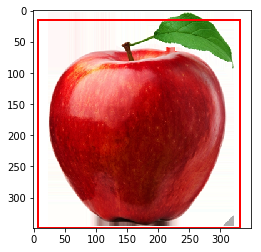

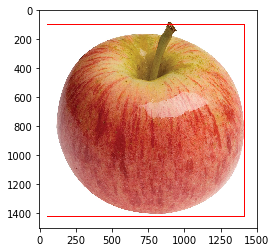

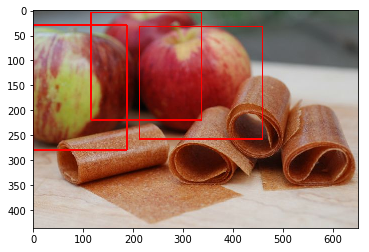

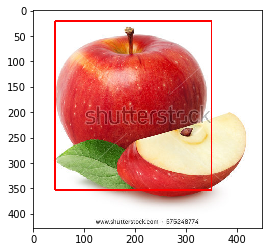

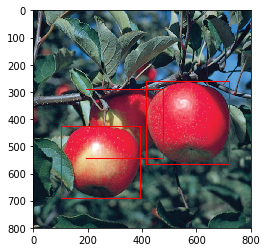

...

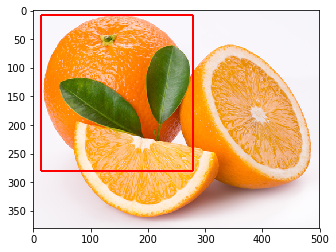

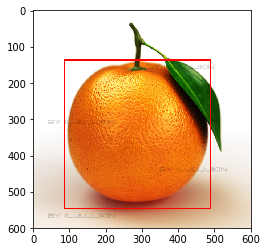

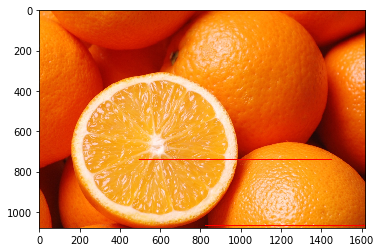

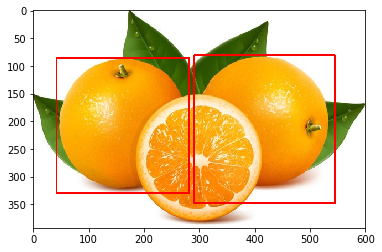

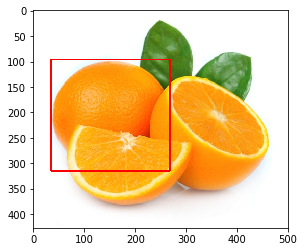

In [30]:
import cv2
import matplotlib.pyplot as plt

for i in range(len(data_jpg)):
    img = cv2.imread(data_jpg[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for j in range(len(object_xmin[i])):
        output=cv2.rectangle(img,(object_xmin[i][j],object_ymin[i][j]),(object_xmax[i][j],object_ymax[i][j]),(255,0,0),2)
    plt.imshow(output)
    plt.show()